True


/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/opt/conda/lib/python3.10/site-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=ResNet50_Weights.IMAGENET1K_V1`. You can also use `weights=ResNet50_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


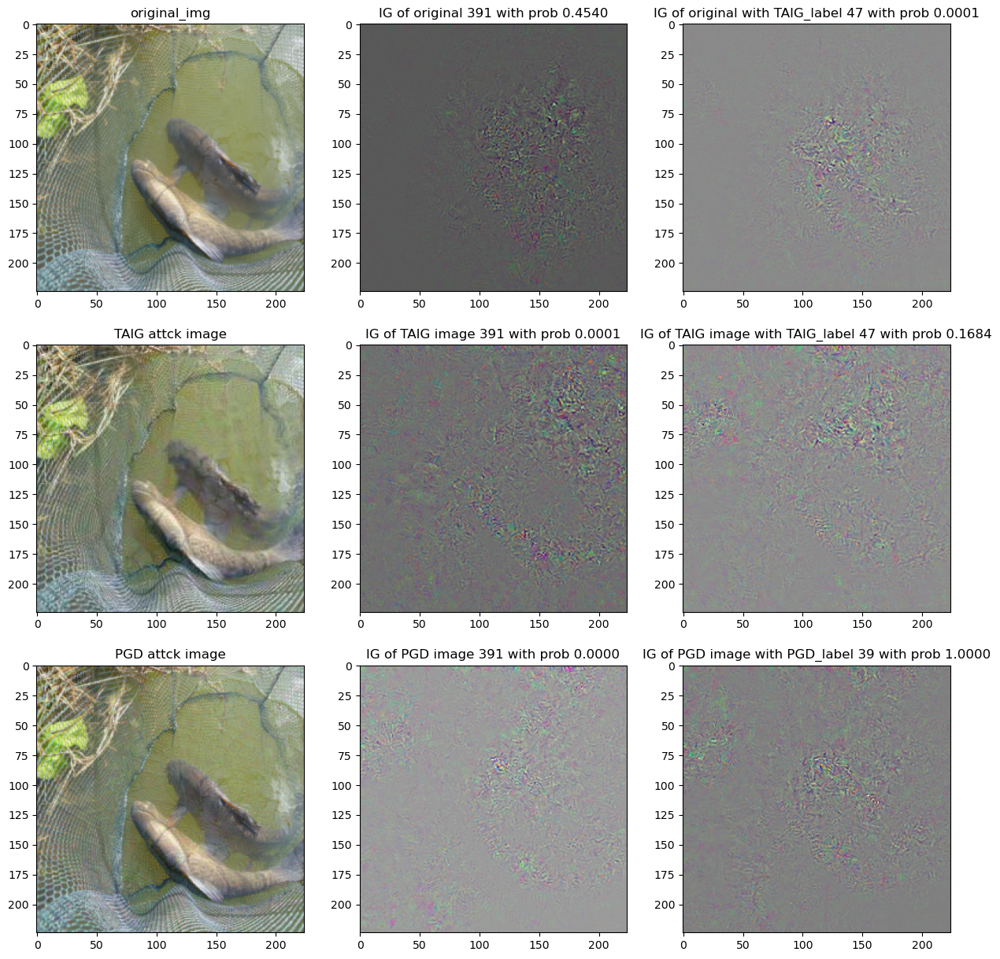

Similarity between IG of original image and TAIG image: 0.9919845461845398
Similarity between IG of original image and PGD image: 0.995357096195221


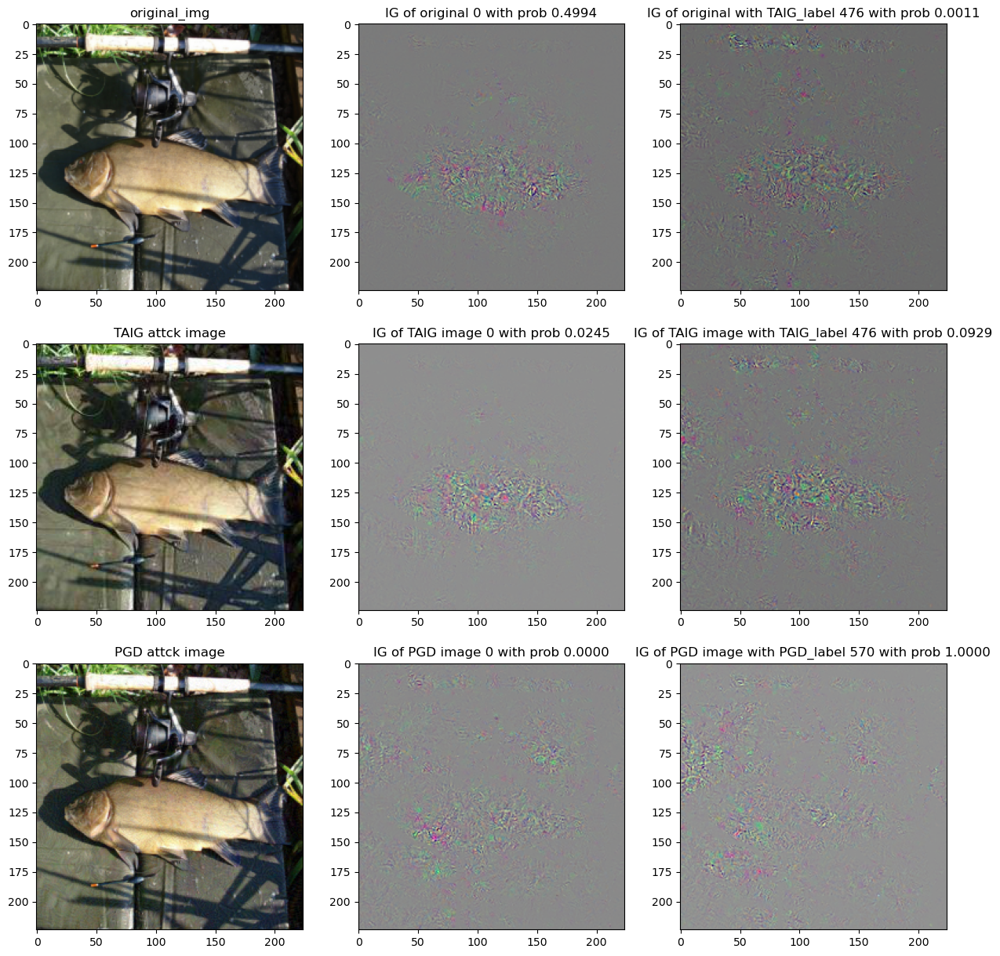

Similarity between IG of original image and TAIG image: 0.9975586533546448
Similarity between IG of original image and PGD image: 0.9970834255218506


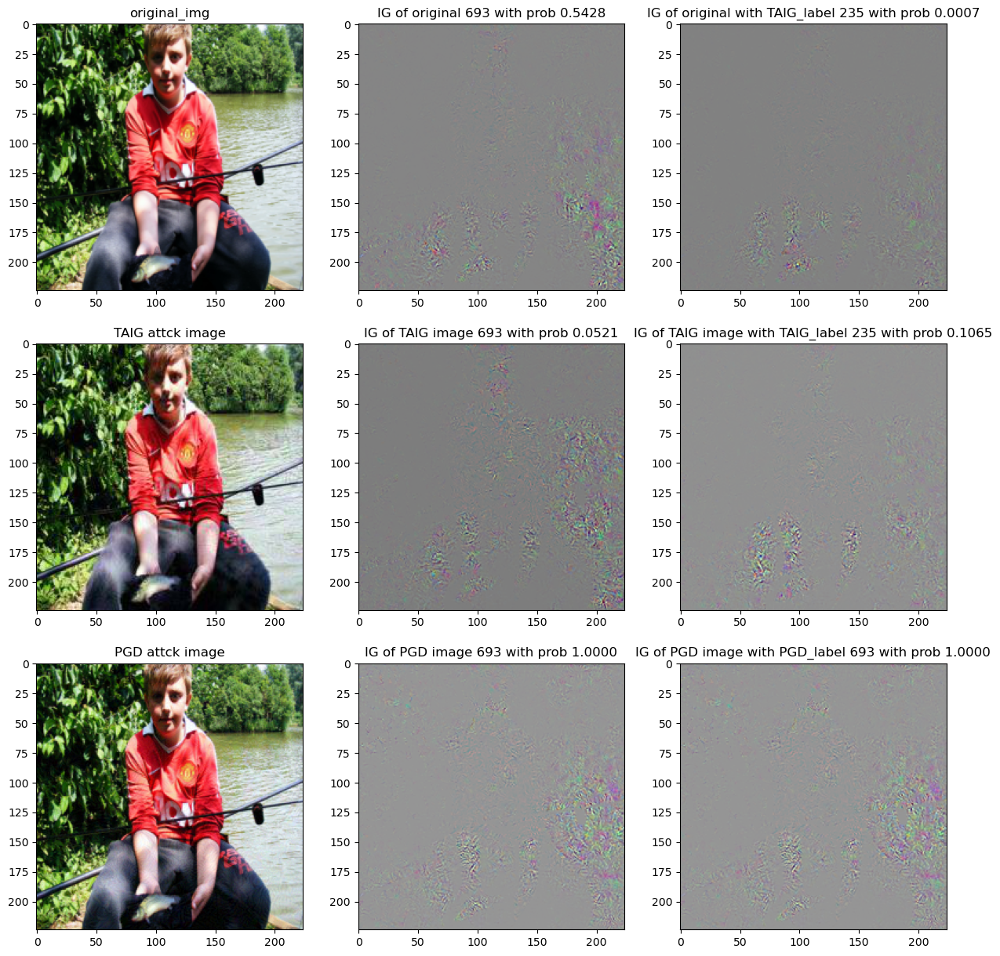

Similarity between IG of original image and TAIG image: 0.9967876672744751
Similarity between IG of original image and PGD image: 0.9971662759780884


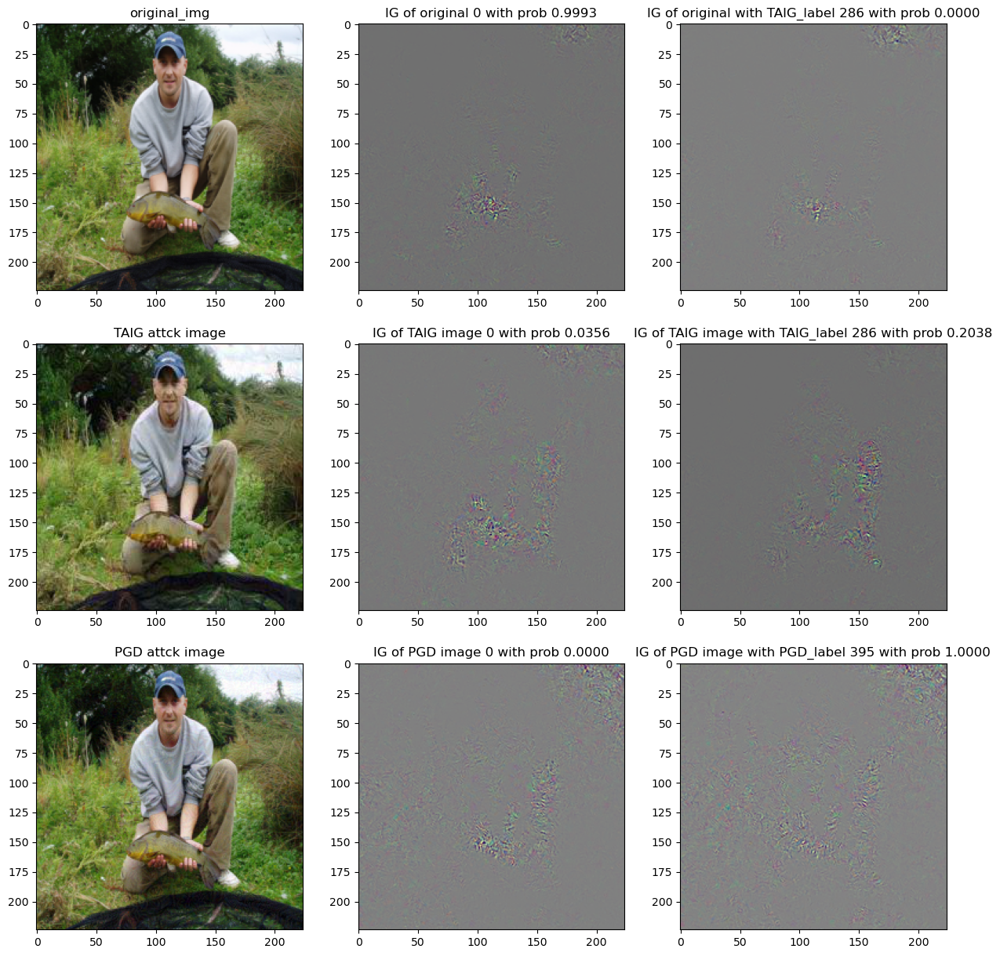

Similarity between IG of original image and TAIG image: 0.9980299472808838
Similarity between IG of original image and PGD image: 0.9980790019035339


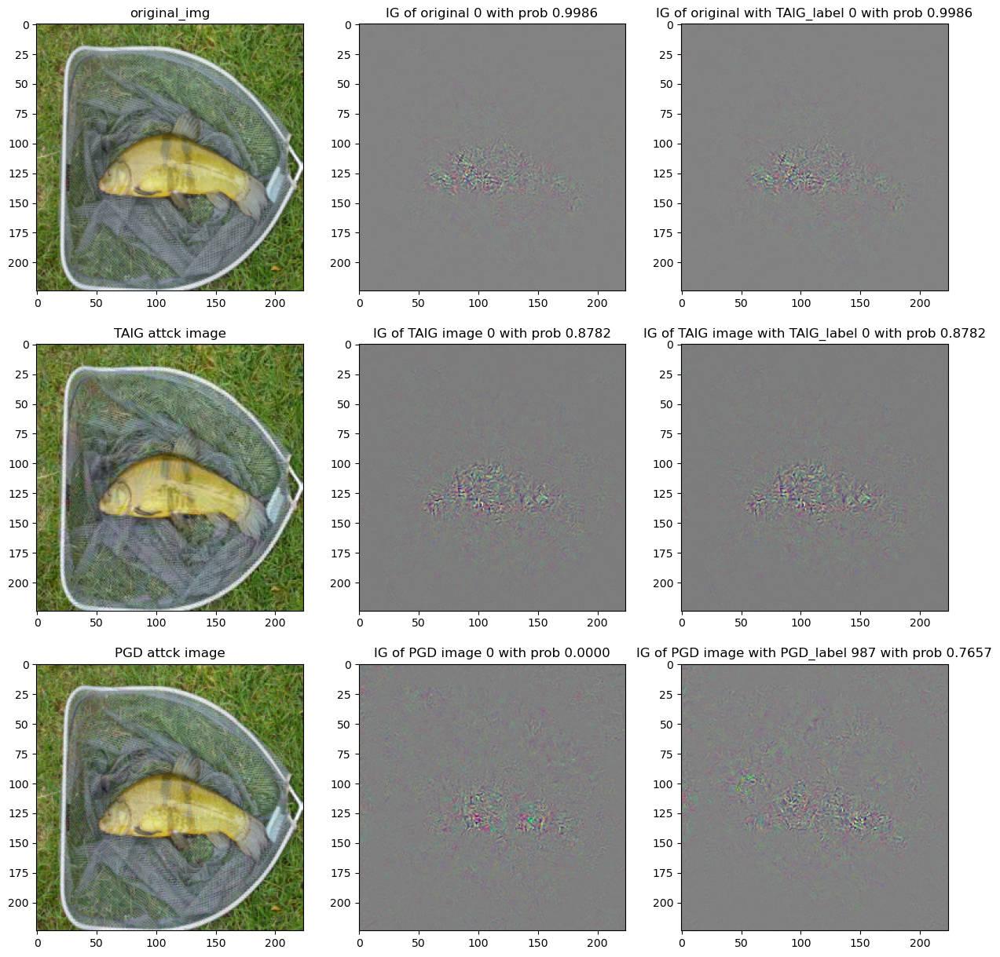

Similarity between IG of original image and TAIG image: 0.9983190894126892
Similarity between IG of original image and PGD image: 0.9981228709220886


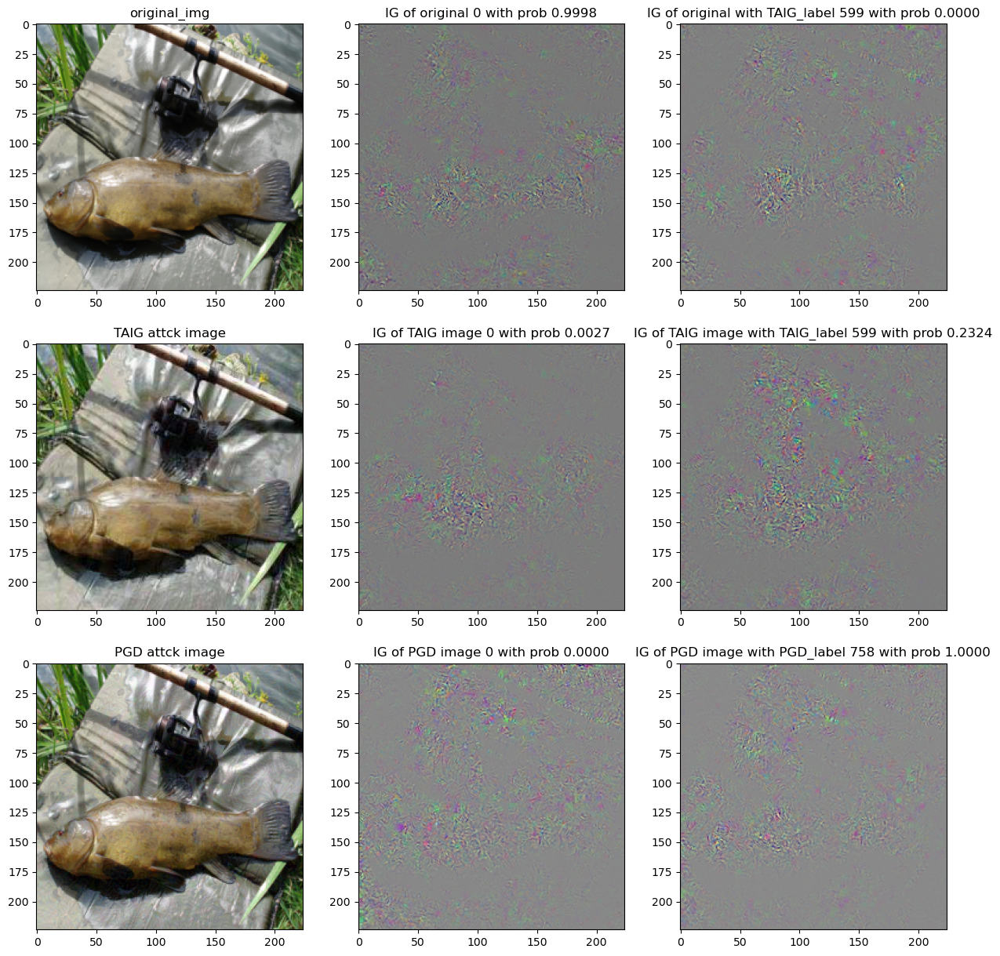

Similarity between IG of original image and TAIG image: 0.9960894584655762
Similarity between IG of original image and PGD image: 0.9948790073394775


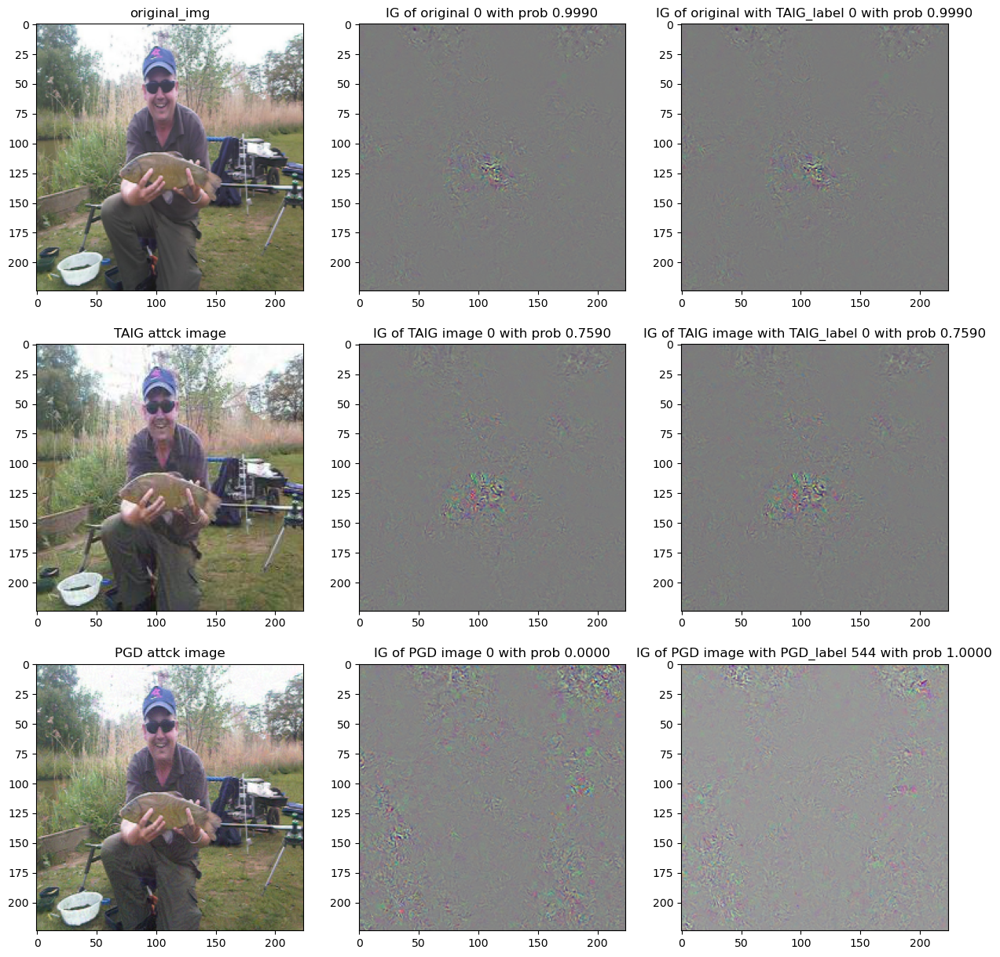

Similarity between IG of original image and TAIG image: 0.9984373450279236
Similarity between IG of original image and PGD image: 0.9970226883888245


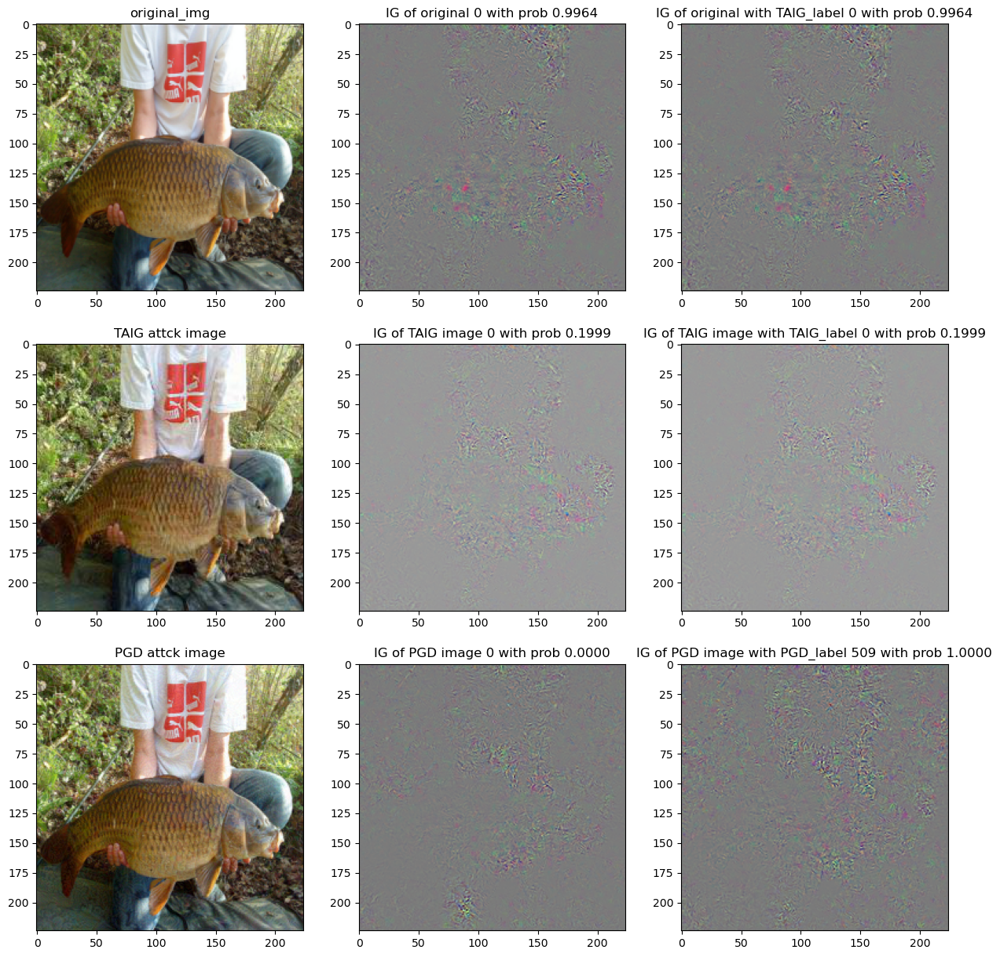

Similarity between IG of original image and TAIG image: 0.9967097043991089
Similarity between IG of original image and PGD image: 0.9961468577384949


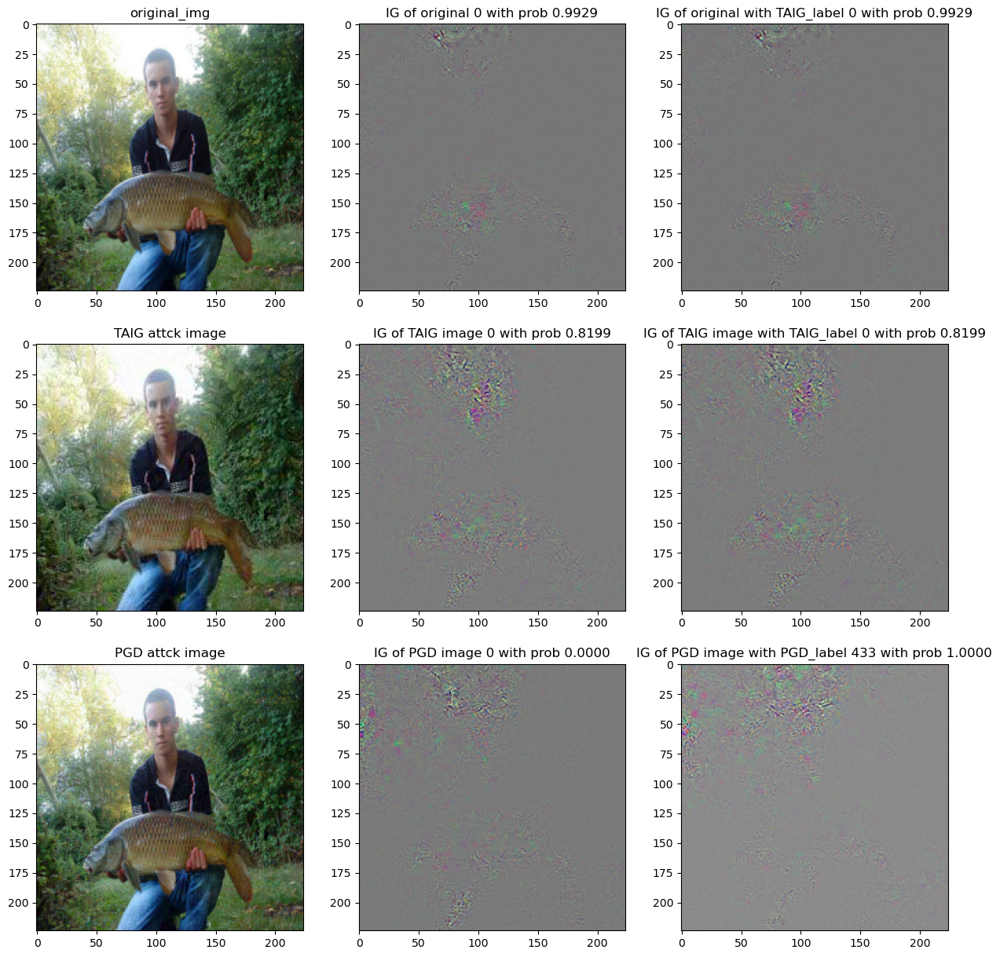

Similarity between IG of original image and TAIG image: 0.9977241158485413
Similarity between IG of original image and PGD image: 0.9978325963020325


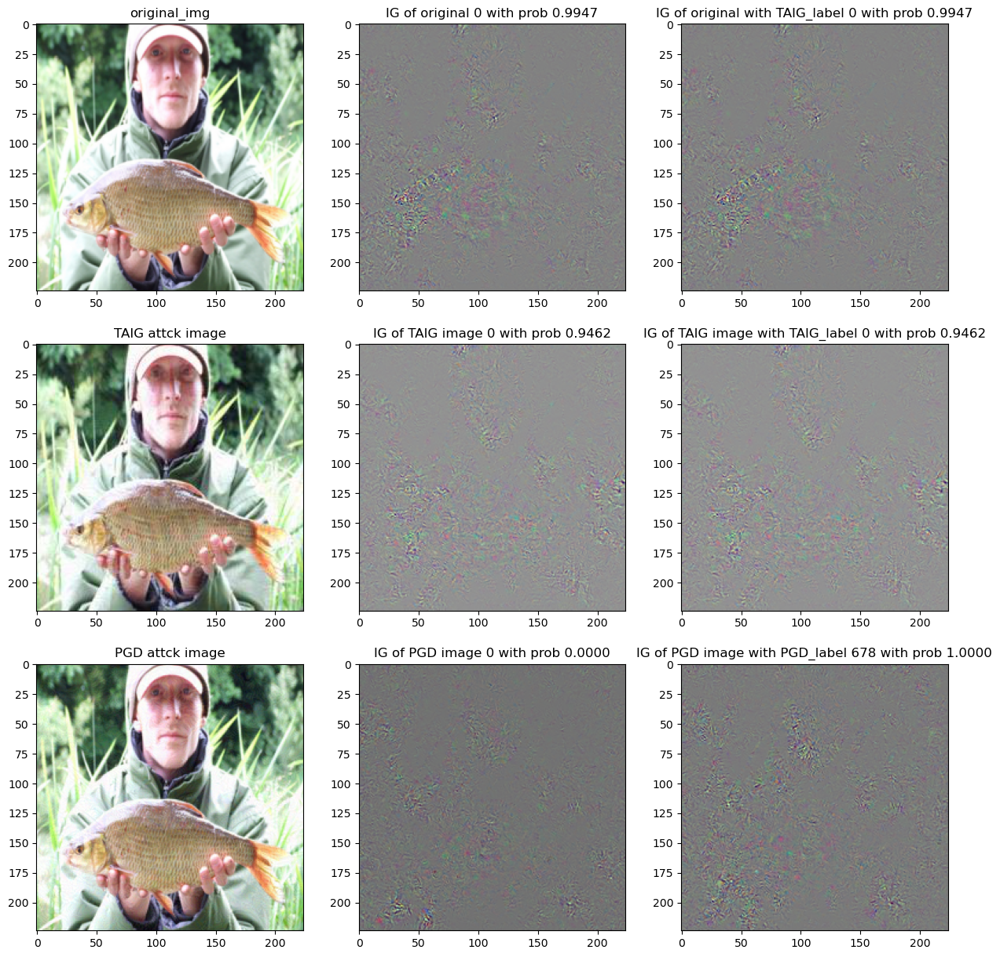

Similarity between IG of original image and TAIG image: 0.996417760848999
Similarity between IG of original image and PGD image: 0.9959568381309509


In [1]:
import numpy as np
import torch
import torchvision.models as models
import torchvision.transforms as transforms
import matplotlib.pyplot as plt
from IG import Integrated_Gradients
from PGD import PGD
from torchvision.datasets import ImageFolder
from torch.utils.data import DataLoader
import torch.nn as nn

cuda = True if torch.cuda.is_available() else False
print(cuda)

# preprocess = transforms.Compose([
#     transforms.RandomResizedCrop(299), # Resize with 256 
#     # transforms.CenterCrop(224), # The input of resnet50 is 224
#     transforms.ToTensor(), # making the matrix shape to [C,H,W] and range of [0,1]
#     transforms.Normalize(
#         mean=[0.5, 0.5, 0.5],
#         std=[0.5, 0.5, 0.5]
#     )
# ])

preprocess = transforms.Compose([
    transforms.Resize((224,224)), # Resize with 256 
    transforms.ToTensor(), # making the matrix shape to [C,H,W] and range of [0,1]
])

norm = transforms.Normalize((0.485, 0.456, 0.406), (0.229, 0.224, 0.225))


val_imagefolder = ImageFolder(root='/workspace/my_data/imagenet/val', transform=preprocess)
val_dataloader = DataLoader(val_imagefolder, batch_size=1, shuffle=False)

TAIG_imagefolder = ImageFolder(root='/workspace/my_data/TAIG_test', transform=preprocess)
TAIG_dataloader = DataLoader(TAIG_imagefolder, batch_size=1, shuffle=False)


model = models.resnet50(pretrained=True)
model = nn.Sequential(norm, model)
model.eval() # batch가 1개일 때 가능하게함 Batchnorm, Dropout 사용안함


IG = Integrated_Gradients(model, cuda=cuda)
PGD = PGD(model, cuda=cuda)

iter = 0
for (ori_imgs, ori_labels), (TAIG_imgs,_) in zip(val_dataloader, TAIG_dataloader):
    
    
    
    ori_predicted_idx, ori_prob, ori_attr = IG(ori_imgs)
    ori_attr = ori_attr.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
    
    _, TAIG_prob, TAIG_attr = IG(TAIG_imgs, ori_predicted_idx)
    TAIG_attr = TAIG_attr.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
    
    pgd_img = PGD(ori_imgs, ori_labels)
    _, pgd_prob, pgd_attr = IG(pgd_img, ori_predicted_idx)
    pgd_attr = pgd_attr.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
    
    TAIG_predicted_idx, prob_TAIG_attr_TAIG_label, TAIG_attr_TAIG_label = IG(TAIG_imgs)
    TAIG_attr_TAIG_label = TAIG_attr_TAIG_label.squeeze(0).detach().cpu().numpy().transpose(1,2,0)

    _, prob_ori_TAIG_label, ori_attr_TAIG_label = IG(ori_imgs, TAIG_predicted_idx)
    ori_attr_TAIG_label = ori_attr_TAIG_label.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
   
    pgd_idx, pgd_prob_pgd_label, pgd_label_attr = IG(pgd_img)
    pgd_label_attr=pgd_label_attr.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
    
    
    
    ori_imgs=ori_imgs.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
    TAIG_imgs=TAIG_imgs.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
    pgd_img=pgd_img.squeeze(0).detach().cpu().numpy().transpose(1,2,0)
    
    fig, axs = plt.subplots(3,3, figsize=(15,15))
    axs[0,0].imshow(ori_imgs)
    axs[0,0].set_title(f'original_img')
    axs[0,1].imshow(ori_attr)
    axs[0,1].set_title(f'IG of original {ori_predicted_idx} with prob {ori_prob:.4f}')
    axs[0,2].imshow(ori_attr_TAIG_label)
    axs[0,2].set_title(f'IG of original with TAIG_label {TAIG_predicted_idx} with prob {prob_ori_TAIG_label:.4f}')
    
    axs[1,0].imshow(TAIG_imgs)
    axs[1,0].set_title(f'TAIG attck image')
    axs[1,1].imshow(TAIG_attr)
    axs[1,1].set_title(f'IG of TAIG image {ori_predicted_idx} with prob {TAIG_prob:.4f}')
    axs[1,2].imshow(TAIG_attr_TAIG_label)
    axs[1,2].set_title(f'IG of TAIG image with TAIG_label {TAIG_predicted_idx} with prob {prob_TAIG_attr_TAIG_label:.4f}')
    
    axs[2,0].imshow(pgd_img)
    axs[2,0].set_title(f'PGD attck image')
    axs[2,1].imshow(pgd_attr)
    axs[2,1].set_title(f'IG of PGD image {ori_predicted_idx} with prob {pgd_prob:.4f}')
    axs[2,2].imshow(pgd_label_attr)
    axs[2,2].set_title(f'IG of PGD image with PGD_label {pgd_idx} with prob {pgd_prob_pgd_label:.4f}')
    
    plt.show()
    
    ori_TAIG_sim = abs(np.dot(ori_attr.reshape(-1), TAIG_attr.reshape(-1)))/(np.linalg.norm(ori_attr.reshape(-1))*np.linalg.norm(TAIG_attr.reshape(-1)))
    ori_PGD_sim = abs(np.dot(ori_attr.reshape(-1), pgd_attr.reshape(-1)))/(np.linalg.norm(ori_attr.reshape(-1))*np.linalg.norm(pgd_attr.reshape(-1)))
    print(f'Similarity between IG of original image and TAIG image: {ori_TAIG_sim}')
    print(f'Similarity between IG of original image and PGD image: {ori_PGD_sim}')
    
    iter += 1
    if iter == 10:
        break